# Code Gradient Descent from Scratch

In [2]:
class LinearRegression_GD:
  def __init__(self, eta = 0.001, max_iter = 20, random_state = 1):
    self.eta = eta
    self.max_iter = max_iter
    self.random_state = random_state
    self.w = None
    self.costs = [ ]

  def net_input(self, X):
    return np.dot(X, self.w[1:]) + self.w[0]

  def predict(self, X):
    return self.net_input(X)
  def fit(self, X, y):
    rgen = np.random.RandomState(self.random_state)
    self.w = rgen.normal(loc = 0.0, scale = 0.01, size = 1 + X.shape[1])
    self.costs = [ ]
    for n_iters in range (self.max_iter):
      error = y - self.predict(X)
      self.w[1:] += self.eta * X.T.dot(error)
      self.w[0] += self.eta * error.sum()
      cost = (error**2).sum() / 2
      self.costs.append(cost)


#***Fish***

# Khai báo thư viện 


In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import seaborn as sns

from collections import Counter
from sklearn.linear_model import SGDRegressor


# Tải và kiểm tra dữ liệu

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [6]:
fish = pd.read_csv('./fish.csv')
type(fish)
fish.describe

<bound method NDFrame.describe of     Species  Weight  Length1  Length2  Length3   Height   Width
0     Bream   242.0     23.2     25.4     30.0  11.5200  4.0200
1     Bream   290.0     24.0     26.3     31.2  12.4800  4.3056
2     Bream   340.0     23.9     26.5     31.1  12.3778  4.6961
3     Bream   363.0     26.3     29.0     33.5  12.7300  4.4555
4     Bream   430.0     26.5     29.0     34.0  12.4440  5.1340
..      ...     ...      ...      ...      ...      ...     ...
154   Smelt    12.2     11.5     12.2     13.4   2.0904  1.3936
155   Smelt    13.4     11.7     12.4     13.5   2.4300  1.2690
156   Smelt    12.2     12.1     13.0     13.8   2.2770  1.2558
157   Smelt    19.7     13.2     14.3     15.2   2.8728  2.0672
158   Smelt    19.9     13.8     15.0     16.2   2.9322  1.8792

[159 rows x 7 columns]>

In [7]:
fish.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 159 entries, 0 to 158
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Species  159 non-null    object 
 1   Weight   159 non-null    float64
 2   Length1  159 non-null    float64
 3   Length2  159 non-null    float64
 4   Length3  159 non-null    float64
 5   Height   159 non-null    float64
 6   Width    159 non-null    float64
dtypes: float64(6), object(1)
memory usage: 8.8+ KB


In [8]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), fish.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [9]:
fish.style.background_gradient(cmap='viridis')

,Species,Weight,Length1,Length2,Length3,Height,Width
0,Bream,242.000000,23.200000,25.400000,30.000000,11.520000,4.020000
1,Bream,290.000000,24.000000,26.300000,31.200000,12.480000,4.305600
2,Bream,340.000000,23.900000,26.500000,31.100000,12.377800,4.696100
3,Bream,363.000000,26.300000,29.000000,33.500000,12.730000,4.455500
4,Bream,430.000000,26.500000,29.000000,34.000000,12.444000,5.134000
5,Bream,450.000000,26.800000,29.700000,34.700000,13.602400,4.927400
6,Bream,500.000000,26.800000,29.700000,34.500000,14.179500,5.278500
7,Bream,390.000000,27.600000,30.000000,35.000000,12.670000,4.690000
8,Bream,450.000000,27.600000,30.000000,35.100000,14.004900,4.843800
9,Bream,500.000000,28.500000,30.700000,36.200000,14.226600,4.959400


#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [10]:
a= []
for c in fish :
  a.append(c)
print(a)

['Species', 'Weight', 'Length1', 'Length2', 'Length3', 'Height', 'Width']


Quan sát thuộc tính Species

In [11]:
sp = fish['Species'].value_counts()
sp = pd.DataFrame(sp)
sp

,Species
Perch,56
Bream,35
Roach,20
Pike,17
Smelt,14
Parkki,11
Whitefish,6


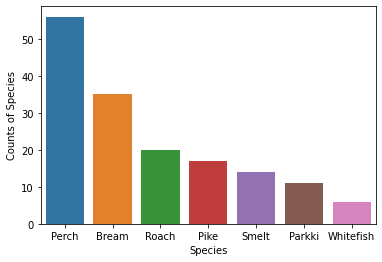

In [12]:
sns.barplot(x=sp.index, y=sp['Species']);
plt.xlabel('Species')
plt.ylabel('Counts of Species')
plt.show()

Mô tả mối liên hệ giữa các thuộc tính của bảng

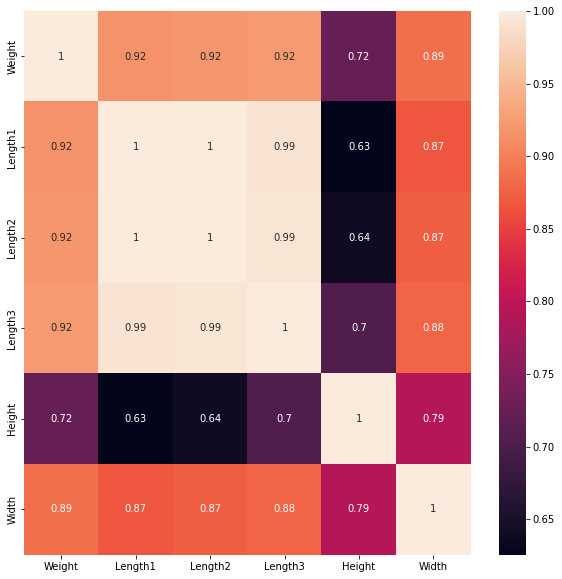

In [13]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(fish[["Weight", "Length1", "Length2", "Length3", "Height", "Width",]].corr(), annot = True)
plt.show()

Qua đây ta thấy Length1, Length2, Length3 là 3 thuộc tính các tương quan với Weight cao nhất 

In [14]:
def corr(species):
    fish1 = fish[fish['Species'] == species]
    fig, ax = plt.subplots(figsize=(5,5)) 
    sns.heatmap(fish1[["Weight", "Length1", "Length2", "Length3", "Height", "Width"]].corr(), annot = True)
    plt.title("Correlation heat map of {} ".format(species))
    plt.show()

Bây giờ ta sẽ xem sự tương quan giữa các thuộc tính trong từng loài

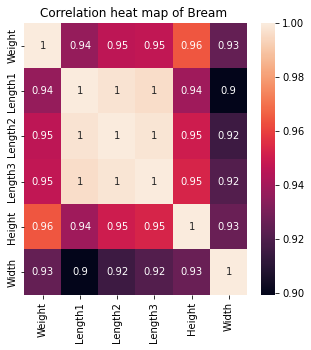

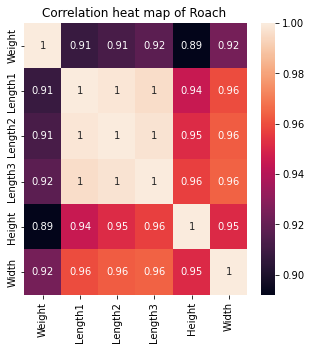

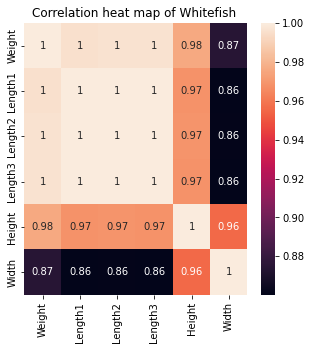

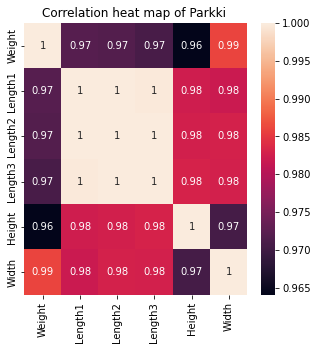

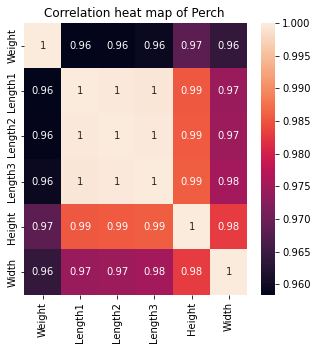

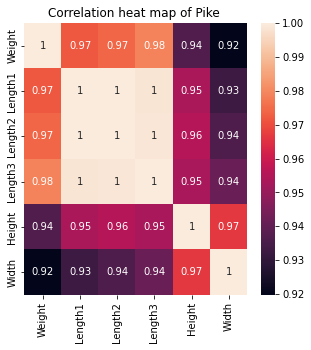

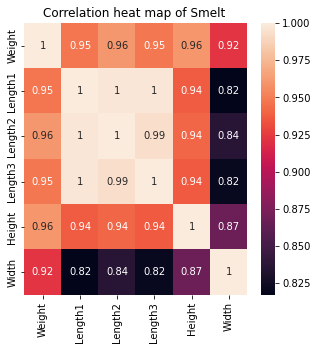

In [15]:
species_list = list(fish['Species'].unique())
for s in species_list:
    corr(s)

Qua đây ta có thể thấy các thuộc tính còn có sự tương quan rất cao với Weight

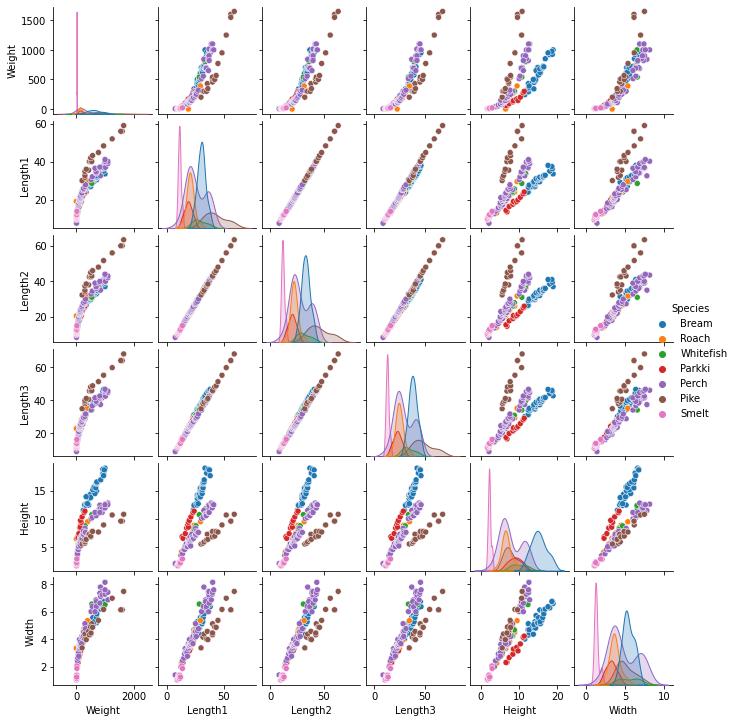

In [16]:
g = sns.pairplot(fish, kind='scatter', hue='Species')
g.fig.set_size_inches(10,10)

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biết với phần còn lại của dữ liệu

In [17]:
def detect_outliers(df,features):
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
        
    
    outlier_indices = Counter(outlier_indices)
    multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    
    return multiple_outliers

In [18]:
fish.loc[detect_outliers(fish,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
142,Pike,1600.0,56.0,60.0,64.0,9.600,6.144
143,Pike,1550.0,56.0,60.0,64.0,9.600,6.144
144,Pike,1650.0,59.0,63.4,68.0,10.812,7.480


Điều nay cho thấy ở Loài Pike có 3 cá thể rất khác biết với toàn thể chung.
Nhưng điều này có phải là khác biệt lớn so với loài của nó không thì chưa rõ, ta cần tìm sự khác biệt trong từng loài

In [19]:
df_pike = fish[fish['Species'] == 'Pike']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


Thấy rằng ở loài Pike không có cá thể khác biệt nào, nên không phải loại bỏ dữ liệu nào

In [20]:
print(fish['Species'].unique())

['Bream' 'Roach' 'Whitefish' 'Parkki' 'Perch' 'Pike' 'Smelt']


In [21]:
df_pike = fish[fish['Species'] == 'Bream']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [22]:
df_pike = fish[fish['Species'] == 'Roach']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
54,Roach,390.0,29.5,31.7,35.0,9.4850,5.355
35,Roach,40.0,12.9,14.1,16.2,4.1472,2.268


Cần loại bỏ 2 dòng dữ liệu 54 và 35 rất khác biệt ở loài Roach

In [23]:
df_pike = fish[fish['Species'] == 'Whitefish']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [24]:
df_pike = fish[fish['Species'] == 'Parkki']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [25]:
df_pike = fish[fish['Species'] == 'Perch']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width


In [26]:
df_pike = fish[fish['Species'] == 'Smelt']
df_pike.loc[detect_outliers(df_pike,["Weight", "Length1", "Length2", "Length3", "Height", "Width"])]

,Species,Weight,Length1,Length2,Length3,Height,Width
157,Smelt,19.7,13.2,14.3,15.2,2.8728,2.0672
158,Smelt,19.9,13.8,15.0,16.2,2.9322,1.8792


Cần loại bỏ 2 dòng dữ liệu 157 và 158 rất khác biệt ở loài Smelt

Tiến hành loại bỏ các dòng dữ liệu "nhiễu" trong bảng dữ liệu

In [27]:
fish1 = fish.drop([35, 54, 157,158])
fish1.info()
fish = fish1

<class 'pandas.core.frame.DataFrame'>
Int64Index: 155 entries, 0 to 156
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Species  155 non-null    object 
 1   Weight   155 non-null    float64
 2   Length1  155 non-null    float64
 3   Length2  155 non-null    float64
 4   Length3  155 non-null    float64
 5   Height   155 non-null    float64
 6   Width    155 non-null    float64
dtypes: float64(6), object(1)
memory usage: 9.7+ KB


In [28]:
fish_feature_names = ["Bias" ,"Species", "Length1", "Length2", "Length3", "Height", "Width"]
#fish_feature_names = fish.columns[2:].values.tolist()
print(type(fish_feature_names))
print(fish_feature_names)

<class 'list'>
['Bias', 'Species', 'Length1', 'Length2', 'Length3', 'Height', 'Width']


In [29]:
countNULL = fish.isna().sum()
print(countNULL)
null_columns = countNULL[countNULL > 0]
print(null_columns)

Species    0
Weight     0
Length1    0
Length2    0
Length3    0
Height     0
Width      0
dtype: int64
Series([], dtype: int64)


In [30]:
print(fish['Species'].unique())
fish['Species'] = LabelEncoder().fit_transform(fish['Species'])
#X.describe
print(fish)

['Bream' 'Roach' 'Whitefish' 'Parkki' 'Perch' 'Pike' 'Smelt']
     Species  Weight  Length1  Length2  Length3   Height   Width
0          0   242.0     23.2     25.4     30.0  11.5200  4.0200
1          0   290.0     24.0     26.3     31.2  12.4800  4.3056
2          0   340.0     23.9     26.5     31.1  12.3778  4.6961
3          0   363.0     26.3     29.0     33.5  12.7300  4.4555
4          0   430.0     26.5     29.0     34.0  12.4440  5.1340
..       ...     ...      ...      ...      ...      ...     ...
152        5     9.9     11.3     11.8     13.1   2.2139  1.1659
153        5     9.8     11.4     12.0     13.2   2.2044  1.1484
154        5    12.2     11.5     12.2     13.4   2.0904  1.3936
155        5    13.4     11.7     12.4     13.5   2.4300  1.2690
156        5    12.2     12.1     13.0     13.8   2.2770  1.2558

[155 rows x 7 columns]


# Tiến hành train dữ liệu

In [31]:
X = fish.drop(columns=['Weight'])
y = fish['Weight']
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)

X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]

#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)

In [32]:
# Cách 1: Gradient Descent
reg_GD = LinearRegression_GD(eta=0.0001, max_iter=10000,random_state=1)
reg_GD.fit(X_train, y_train)
y_pred_GD = reg_GD.predict(X_test)
print(y_pred_GD)

[ 749.7307483    88.07036662  775.40043481 -174.61876451  657.57950452
 -221.0840644   103.34417451  240.06475429  402.02821006  726.32061256
  136.48663316    6.81560458  226.02814932  490.1487655    88.33077663
  154.71799497  384.11274235  685.29744193  604.97581787  761.70796129
   95.70727056  128.24486166  761.70796129  831.27258398  686.23522907
  309.29222797  912.39779918  576.78722952   30.89512069  362.60630421
  460.22376268  578.21635499  571.06191188  722.51600006  588.86292531
  113.34570063  226.85462631  539.43711791  536.83143807  611.32410977
 -196.29294118  166.06173214  439.05829222   81.3668385   192.21809317
 -188.36731947  407.75838598]


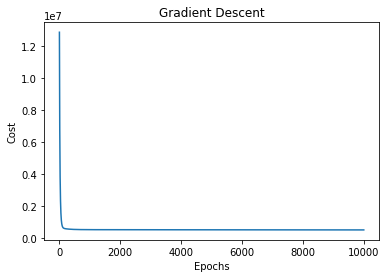

In [33]:
plt.plot(range(1, len(reg_GD.costs) + 1), reg_GD.costs)
plt.xlabel('Epochs')
plt.ylabel('Cost')
plt.title('Gradient Descent')
plt.show()

In [34]:
#Cách 2: So sánh với Normal Equation
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X_train,y_train)
y_pred_NE = np.dot(X_test,beta1)
print(y_pred_NE)

[ 785.65550848   61.76235315  801.26963055 -165.36943914  675.94606862
 -219.09485708   87.92197754  242.47774255  397.9126338   743.48672737
  124.71213397    5.00054538  198.27324851  499.8220369    56.07278724
  156.32374473  374.02449929  697.97516203  608.1588135   725.8554875
   74.84216534  110.71911864  725.8554875   900.60244755  689.39075449
  311.13069866  844.64123367  607.81097411   24.95202538  345.25473342
  481.88681515  594.70336836  592.53571103  737.58084111  615.58036204
   71.90841953  256.98892041  498.68767803  546.83760176  602.69242846
 -193.65036814  203.15496612  478.90394319   52.07880446  176.85414883
 -184.71546472  405.66686224]


In [35]:
# Cách 3: Kiểm chứng bằng thư viện
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_train, y_train)
y_pred_L = reg.predict(X_test)
print(y_pred_L)

[ 785.65550848   61.76235315  801.26963055 -165.36943914  675.94606862
 -219.09485708   87.92197754  242.47774255  397.9126338   743.48672737
  124.71213397    5.00054538  198.27324851  499.8220369    56.07278724
  156.32374473  374.02449929  697.97516203  608.1588135   725.8554875
   74.84216534  110.71911864  725.8554875   900.60244755  689.39075449
  311.13069866  844.64123367  607.81097411   24.95202538  345.25473342
  481.88681515  594.70336836  592.53571103  737.58084111  615.58036204
   71.90841953  256.98892041  498.68767803  546.83760176  602.69242846
 -193.65036814  203.15496612  478.90394319   52.07880446  176.85414883
 -184.71546472  405.66686224]


In [36]:
#Cách 4:
reg_SGD = SGDRegressor(eta0=0.001, max_iter=20,random_state=1, l1_ratio=0, tol=None, learning_rate='constant')
reg_SGD.fit(X_train, y_train)
y_pred_SGD = reg_SGD.predict(X_test)
print(y_pred_SGD)

[ 630.01711942  119.84166591  734.92175391 -172.0367854   624.3506627
 -214.38127884  128.28849515  257.49845436  313.68125915  693.16088511
  161.14815954   46.03375039  201.82069421  492.81878628  113.76719696
  139.16905767  418.94812517  644.93903376  570.6328462   834.05939715
  124.06508053  110.51056871  834.05939715  772.20184769  648.26101839
  322.65705898  965.52557593  562.81106105   56.17284813  368.84114238
  456.01153285  565.16956871  548.27061778  670.64357108  554.72022093
  139.73026561  240.31229266  599.83480736  507.59764516  478.46379822
 -192.91060787  170.51251085  449.00426228  108.50116603  176.28294566
 -190.14869998  424.39538569]


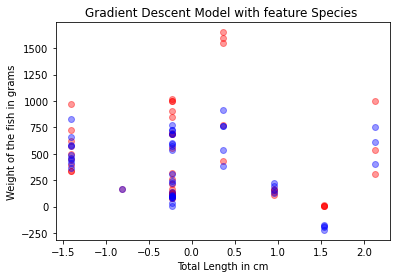

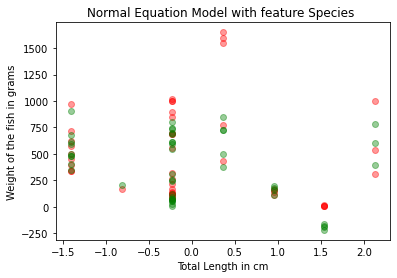

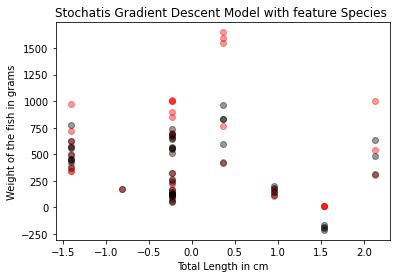

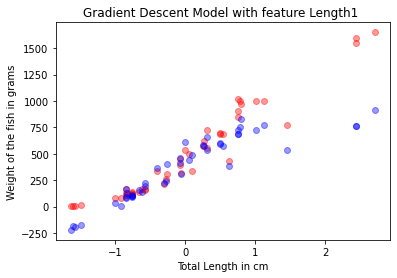

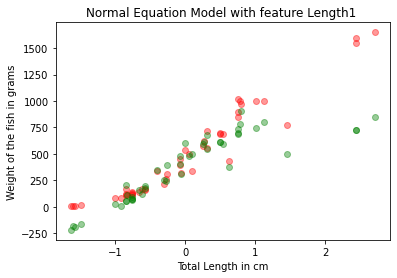

...

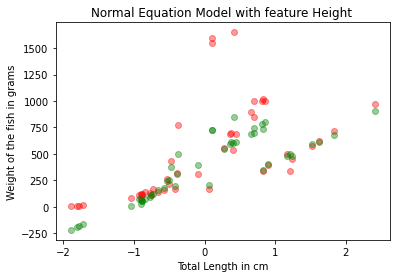

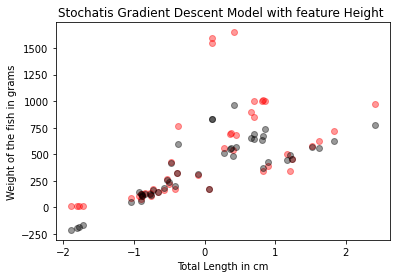

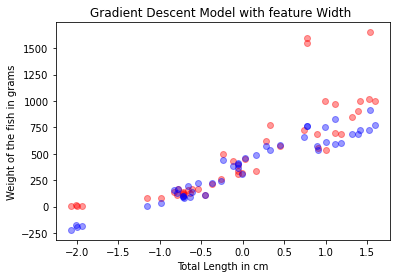

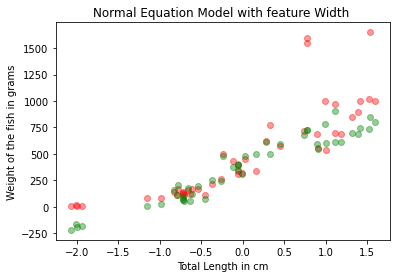

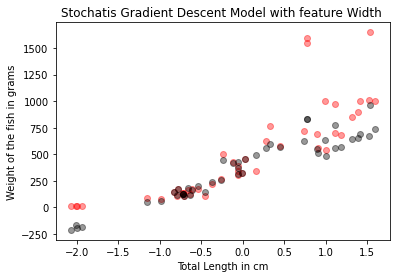

In [37]:
X_train = pd.DataFrame(X_train, columns = fish_feature_names)
X_test = pd.DataFrame(X_test, columns = fish_feature_names)
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_GD, color='blue', alpha=0.4) #Predicted data
  plt.title("Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('Total Length in cm')
  plt.ylabel('Weight of the fish in grams')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_NE, color='green', alpha=0.4) #Predicted data
  plt.title("Normal Equation Model with feature {} ".format(feature))
  plt.xlabel('Total Length in cm')
  plt.ylabel('Weight of the fish in grams')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_SGD, color='Black', alpha=0.4) #Predicted data
  plt.title("Stochatis Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('Total Length in cm')
  plt.ylabel('Weight of the fish in grams')
  plt.show();




for feature in fish_feature_names :
  if feature != "Bias":
    visualize_result(feature)

In [38]:
from sklearn.metrics import r2_score
print(r2_score(y_test, y_pred_NE))
print(r2_score(y_test, y_pred_GD))
print(r2_score(y_test, y_pred_SGD))

0.6813900100302237
0.7012807941056769
0.7160899032756233


In [39]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_pred_NE,y_test))
print(mean_squared_error(y_pred_GD,y_test))
print(mean_squared_error(y_pred_SGD,y_test))

58112.86211371375
54484.88298970662
51783.77584833399


### ***Insurance***

# Khai báo thư viện 


In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import seaborn as sns

from collections import Counter


# Tải và kiểm tra dữ liệu

In [41]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [42]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [43]:
insurance = pd.read_csv('./insurance.csv')
insurance1 = insurance
type(insurance)
insurance.describe

<bound method NDFrame.describe of       age     sex     bmi  children smoker     region      charges
0      19  female  27.900         0    yes  southwest  16884.92400
1      18    male  33.770         1     no  southeast   1725.55230
2      28    male  33.000         3     no  southeast   4449.46200
3      33    male  22.705         0     no  northwest  21984.47061
4      32    male  28.880         0     no  northwest   3866.85520
...   ...     ...     ...       ...    ...        ...          ...
1333   50    male  30.970         3     no  northwest  10600.54830
1334   18  female  31.920         0     no  northeast   2205.98080
1335   18  female  36.850         0     no  southeast   1629.83350
1336   21  female  25.800         0     no  southwest   2007.94500
1337   61  female  29.070         0    yes  northwest  29141.36030

[1338 rows x 7 columns]>

In [44]:
insurance.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1338 entries, 0 to 1337
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       1338 non-null   int64  
 1   sex       1338 non-null   object 
 2   bmi       1338 non-null   float64
 3   children  1338 non-null   int64  
 4   smoker    1338 non-null   object 
 5   region    1338 non-null   object 
 6   charges   1338 non-null   float64
dtypes: float64(2), int64(2), object(3)
memory usage: 73.3+ KB


In [45]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), insurance.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [46]:
insurance.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [47]:
a= []
for c in insurance :
  a.append(c)
print(a)

['age', 'sex', 'bmi', 'children', 'smoker', 'region', 'charges']


In [48]:
print(insurance['sex'].unique())
insurance['sex'] = LabelEncoder().fit_transform(insurance['sex']) # nữ :0 , nam : 1
print(insurance['smoker'].unique())
insurance['smoker'] = LabelEncoder().fit_transform(insurance['smoker']) # yes : 1, no : 0

['female' 'male']
['yes' 'no']


Quan sát thuộc tính Species

In [49]:
sp = insurance['region'].value_counts()
sp = pd.DataFrame(sp)
sp

,region
southeast,364
northwest,325
southwest,325
northeast,324


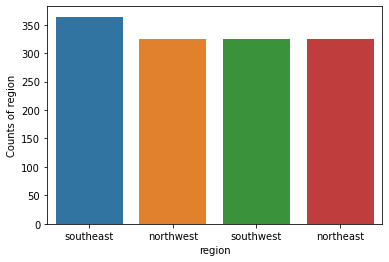

In [50]:
sns.barplot(x=sp.index, y=sp['region']);
plt.xlabel('region')
plt.ylabel('Counts of region')
plt.show()

Mô tả mối liên hệ giữa các thuộc tính của bảng

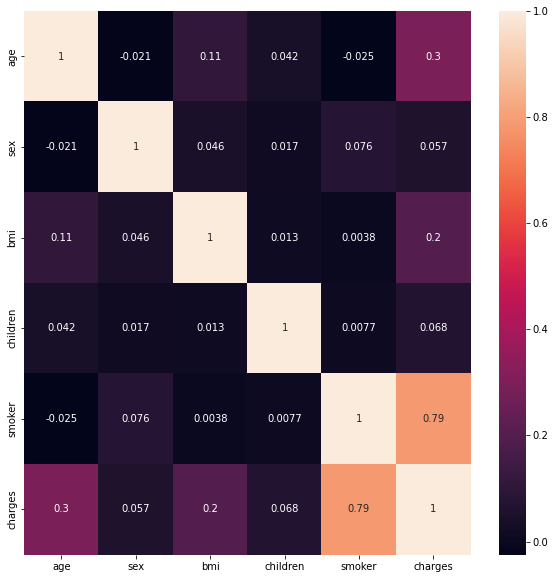

In [51]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(insurance[["age", "sex", "bmi", "children", "smoker", "region","charges"]].corr(), annot = True)
plt.show()

Qua đây ta thấy smoker là dữ liệu có tương quan cao nhất với charges. Các dữ liệu còn lại cho dữ kiện liên quan rất thấp

In [52]:
def corr(region):
    insurance1 = insurance[insurance['region'] == region]
    fig, ax = plt.subplots(figsize=(5,5)) 
    sns.heatmap(insurance1[["age", "sex", "bmi", "children", "smoker", "region","charges"]].corr(), annot = True)
    plt.title("Correlation heat map of {} ".format(region))
    plt.show()

Bây giờ ta sẽ xem sự tương quan giữa các thuộc tính trong từng loài

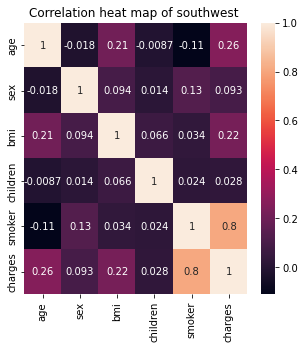

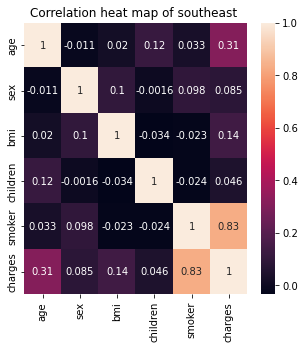

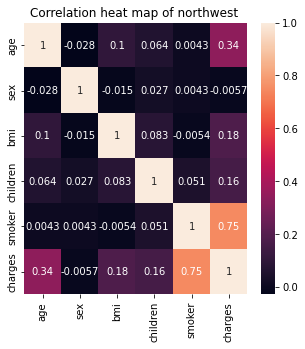

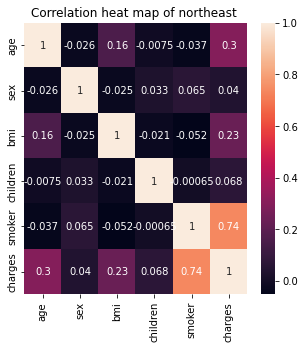

In [53]:
region_list = list(insurance['region'].unique())
for s in region_list:
    corr(s)

Qua đây ta có thể thấy các thuộc tính smoker, age, và bmi có sự tương quan ở mức tạm chấp nhận được

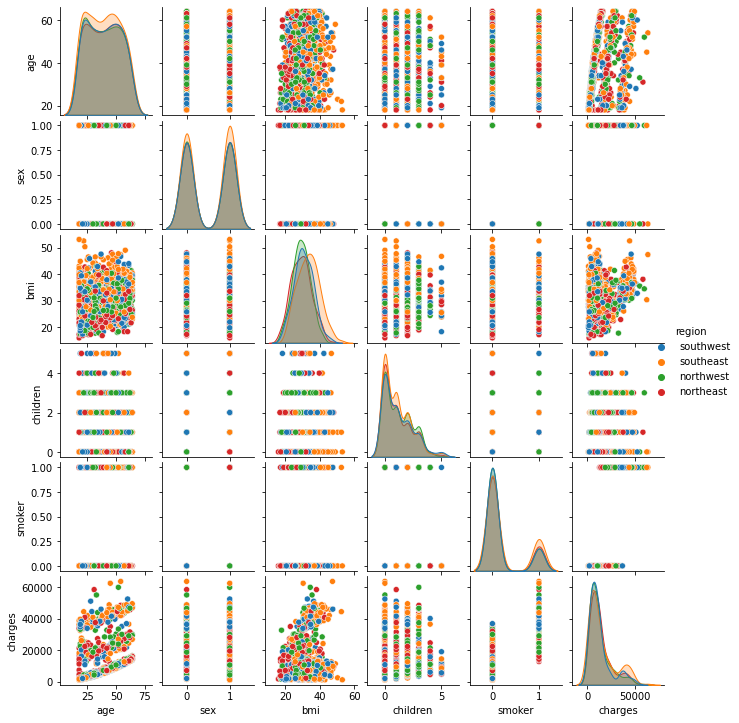

In [54]:
g = sns.pairplot(insurance, kind='scatter', hue='region')
g.fig.set_size_inches(10,10)

Giờ ta sẽ xem tương quan của region với charges

In [55]:
print(insurance['region'].unique())
insurance['region'] = LabelEncoder().fit_transform(insurance['region']) 
print(insurance['region'].unique())


['southwest' 'southeast' 'northwest' 'northeast']
[3 2 1 0]


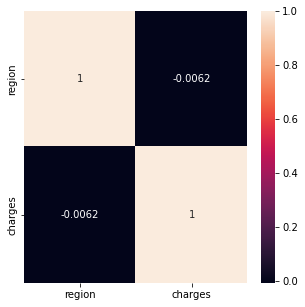

In [56]:
fig, ax = plt.subplots(figsize=(5,5)) 
sns.heatmap(insurance[["region","charges"]].corr(), annot = True)
plt.show()

Qua đây cũng thấy region có tương quan rất thấp với charges
Sau khi quan sát dữ liệu, ta sẽ sử dụng 3 trường dữ liệu là age, bmi, smoker để dự đoán cho charges

---



Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [57]:
def detect_outliers(df,features,redetect=False):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        if redetect == False:
          outlier_step = IQR * 1.5
        else:
            outlier_step = IQR * 1
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [58]:
x = detect_outliers(insurance,["age", "bmi", "smoker", "region","charges"])
new_insurance = insurance.loc[x]
print(new_insurance.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3 entries, 543 to 1047
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   age       3 non-null      int64  
 1   sex       3 non-null      int64  
 2   bmi       3 non-null      float64
 3   children  3 non-null      int64  
 4   smoker    3 non-null      int64  
 5   region    3 non-null      int64  
 6   charges   3 non-null      float64
dtypes: float64(2), int64(5)
memory usage: 192.0 bytes
None


In [59]:
new_insurance.style.background_gradient(cmap='viridis')

,age,sex,bmi,children,smoker,region,charges
543,54,0,47.410000,0,1,2,63770.428010
860,37,0,47.600000,2,1,3,46113.511000
1047,22,1,52.580000,1,1,2,44501.398200


Ta sẽ loại bỏ 3 dữ liệu này

In [60]:
insurance = insurance.drop(x)

In [61]:
insurane_feature_names = ['bias','age','bmi','smoker']

print(type(insurane_feature_names))
print(insurane_feature_names)

<class 'list'>
['bias', 'age', 'bmi', 'smoker']


#Tiến hành train dữ liệu

In [62]:
X = insurance.drop(columns=['charges','sex','children','region'])
y = insurance['charges']
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1))*2, X_train]
X_test = np.c_[np.ones((len(X_test), 1))*2, X_test]

In [63]:
# Cách 1: Gradient Descent
reg_GD = LinearRegression_GD(eta=0.0001, max_iter=10000,random_state=1)
reg_GD.fit(X_train, y_train)
y_pred_GD = reg_GD.predict(X_test)
#print(y_pred_GD)

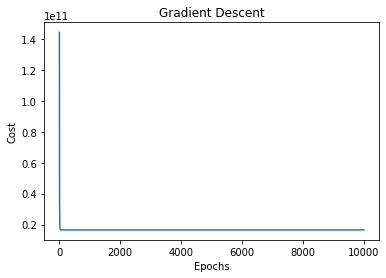

In [64]:
plt.plot(range(1, len(reg_GD.costs) + 1), reg_GD.costs)
plt.xlabel('Epochs')
plt.ylabel('Cost')
plt.title('Gradient Descent')
plt.show()

In [65]:
#Cách 2: So sánh với Normal Equation
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X_train,y_train)
y_pred_NE = np.dot(X_test,beta1)
#print(y_pred_NE)

In [66]:
# Cách 3: Kiểm chứng bằng thư viện
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_train, y_train)
y_pred_L = reg.predict(X_test)
#print(y_pred_L)

In [67]:
#Cách 4:
reg_SGD = SGDRegressor(eta0=0.001, max_iter=20,random_state=1, l1_ratio=0, tol=None, learning_rate='constant')
reg_SGD.fit(X_train, y_train)
y_pred_SGD = reg_SGD.predict(X_test)
#print(y_pred_SGD)

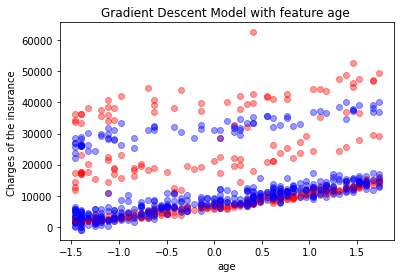

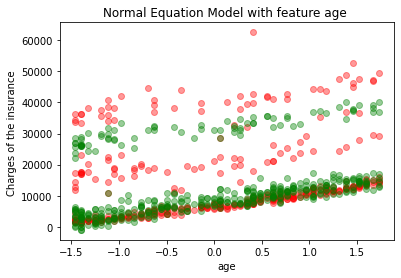

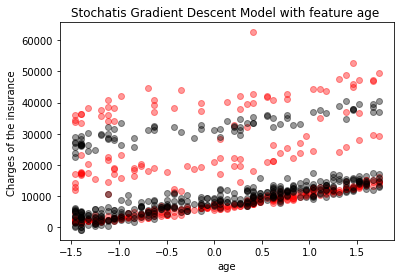

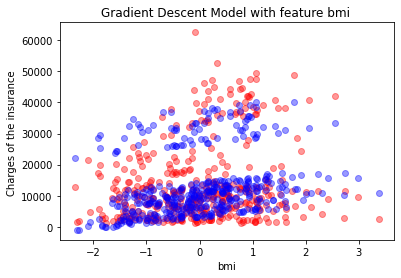

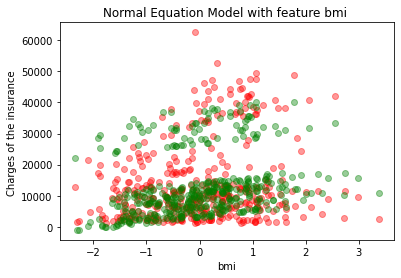

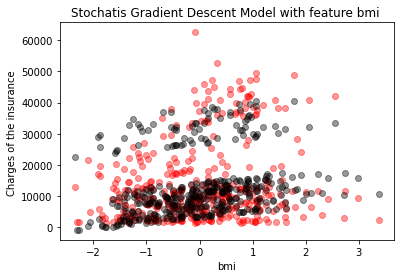

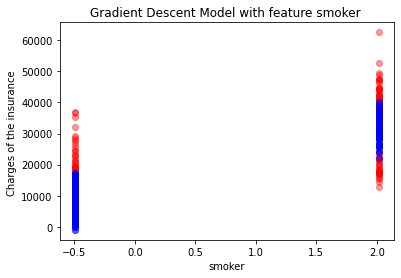

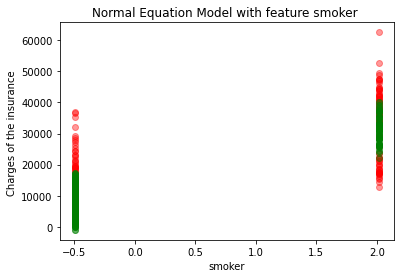

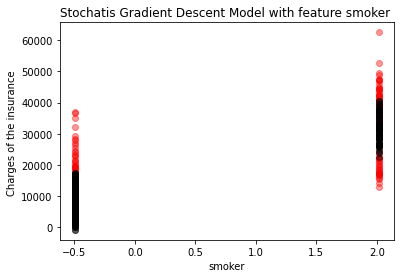

In [71]:
X_train = pd.DataFrame(X_train, columns = insurane_feature_names)
X_test = pd.DataFrame(X_test, columns = insurane_feature_names)
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_GD, color='blue', alpha=0.4) #Predicted data
  plt.title("Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Charges of the insurance ')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_NE, color='green', alpha=0.4) #Predicted data
  plt.title("Normal Equation Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Charges of the insurance ')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_SGD, color='Black', alpha=0.4) #Predicted data
  plt.title("Stochatis Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Charges of the insurance ')
  plt.show();




for feature in insurane_feature_names :
  if feature != "bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [72]:
from sklearn.metrics import r2_score
print(r2_score(y_test, y_pred_NE))
print(r2_score(y_test, y_pred_GD))
print(r2_score(y_test, y_pred_SGD))

0.738740952942839
0.7387409529428388
0.739890142551688


In [73]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_pred_NE,y_test))
print(mean_squared_error(y_pred_GD,y_test))
print(mean_squared_error(y_pred_SGD,y_test))

39440220.58005829
39440220.580058336
39266736.47617041


# ***Wine***

# Khai báo thư viện 


In [74]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go

from collections import Counter


# Tải và kiểm tra dữ liệu

In [75]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [76]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [77]:
wine = pd.read_csv('./wine.csv')
type(wine)
wine.describe

<bound method NDFrame.describe of       fixed acidity  volatile acidity  citric acid  ...  sulphates  alcohol  quality
0               7.4             0.700         0.00  ...       0.56      9.4        5
1               7.8             0.880         0.00  ...       0.68      9.8        5
2               7.8             0.760         0.04  ...       0.65      9.8        5
3              11.2             0.280         0.56  ...       0.58      9.8        6
4               7.4             0.700         0.00  ...       0.56      9.4        5
...             ...               ...          ...  ...        ...      ...      ...
1594            6.2             0.600         0.08  ...       0.58     10.5        5
1595            5.9             0.550         0.10  ...       0.76     11.2        6
1596            6.3             0.510         0.13  ...       0.75     11.0        6
1597            5.9             0.645         0.12  ...       0.71     10.2        5
1598            6.0            

In [78]:
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [79]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), wine.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [80]:
wine.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [81]:
a= []
for c in wine :
  a.append(c)
print(a)

['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']


Mô tả mối liên hệ giữa các thuộc tính của bảng

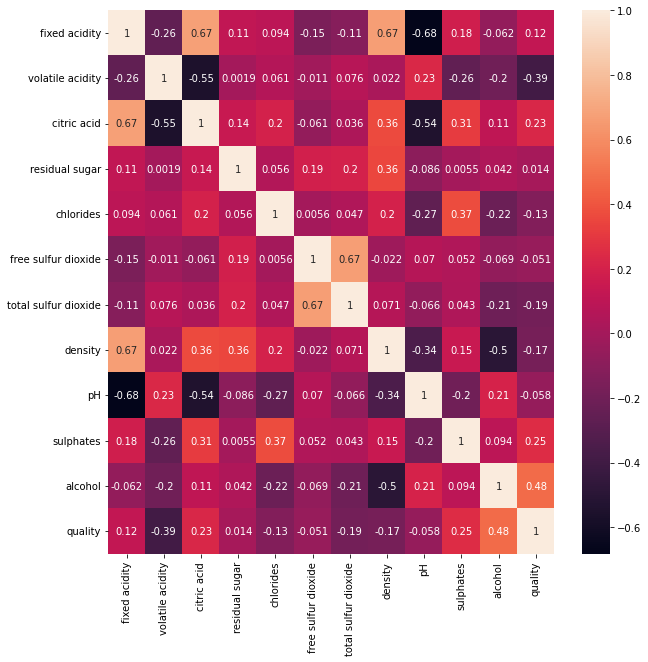

In [82]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(wine[['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality']].corr(), annot = True)
plt.show()

Qua đây ta thấy alcohol là dữ liệu có tương quan cao nhất với quality.
Các dữ liệu còn lại có mối tương quan lẫn nhau. Residual sugar có tương quan thấp với quality nhưng lại đáng kể với density, total sulfur dioxide, free sulfur dioxide nên không thể loại trường dữ liệu này. Tương tự free sulfur dioxide cũng có tương quan đáng kể với total sulfur dioxide.

Qua đây ta có thể thấy các thuộc tính smoker, age, và bmi có sự tương quan ở mức tạm chấp nhận được

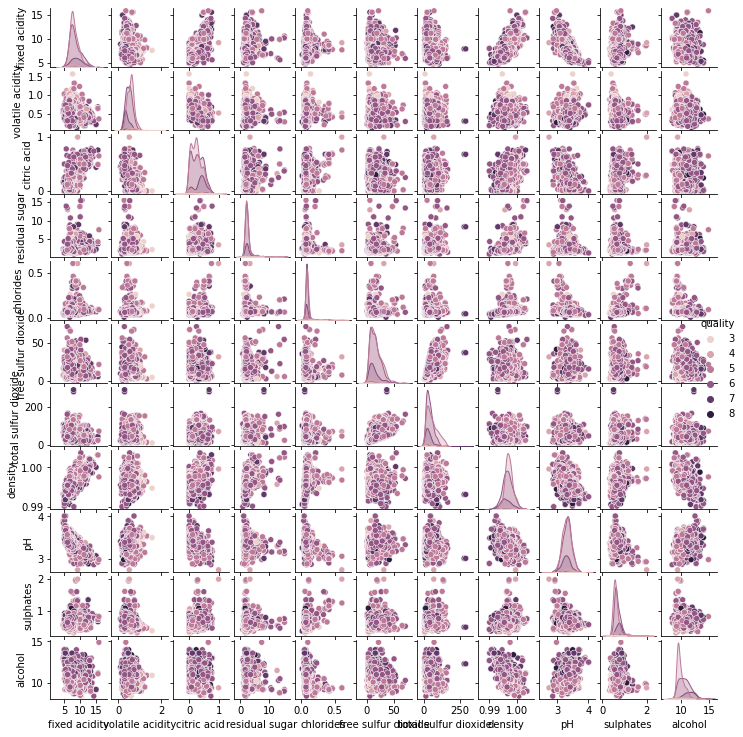

In [83]:
g = sns.pairplot(wine, kind='scatter', hue='quality')
g.fig.set_size_inches(10,10)

In [84]:
print(wine['quality'].unique())

[5 6 7 4 8 3]


In [85]:
sp = wine['quality'].value_counts()
sp = pd.DataFrame(sp)
sp

,quality
5,681
6,638
7,199
4,53
8,18
3,10


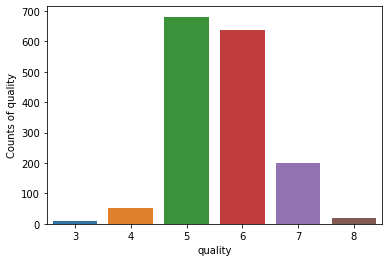

In [86]:
sns.barplot(x=sp.index, y=sp['quality']);
plt.xlabel('quality')
plt.ylabel('Counts of quality')
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



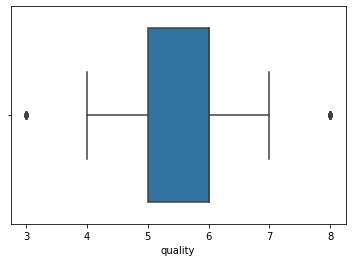

In [87]:
sns.boxplot(wine['quality'])

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [88]:
def detect_outliers(df,features,redetect=False):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        if redetect == False:
          outlier_step = IQR * 1.5
        else:
            outlier_step = IQR * 1
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [89]:
x = detect_outliers(wine,['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol', 'quality'])
new_wine = wine.loc[x]
print(new_wine.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37 entries, 353 to 1270
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         37 non-null     float64
 1   volatile acidity      37 non-null     float64
 2   citric acid           37 non-null     float64
 3   residual sugar        37 non-null     float64
 4   chlorides             37 non-null     float64
 5   free sulfur dioxide   37 non-null     float64
 6   total sulfur dioxide  37 non-null     float64
 7   density               37 non-null     float64
 8   pH                    37 non-null     float64
 9   sulphates             37 non-null     float64
 10  alcohol               37 non-null     float64
 11  quality               37 non-null     int64  
dtypes: float64(11), int64(1)
memory usage: 3.8 KB
None


In [90]:
new_wine.style.background_gradient(cmap='viridis')

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
353,13.500000,0.530000,0.790000,4.800000,0.120000,23.000000,77.000000,1.001800,3.180000,0.770000,13.000000,5
364,12.800000,0.615000,0.660000,5.800000,0.083000,7.000000,42.000000,1.002200,3.070000,0.730000,10.000000,7
366,12.800000,0.615000,0.660000,5.800000,0.083000,7.000000,42.000000,1.002200,3.070000,0.730000,10.000000,7
374,14.000000,0.410000,0.630000,3.800000,0.089000,6.000000,47.000000,1.001400,3.010000,0.810000,10.800000,6
440,12.600000,0.310000,0.720000,2.200000,0.072000,6.000000,29.000000,0.998700,2.880000,0.820000,9.800000,8
442,15.600000,0.685000,0.760000,3.700000,0.100000,6.000000,43.000000,1.003200,2.950000,0.680000,11.200000,7
538,12.900000,0.350000,0.490000,5.800000,0.066000,5.000000,35.000000,1.001400,3.200000,0.660000,12.000000,7
554,15.500000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5
555,15.500000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5
557,15.600000,0.645000,0.490000,4.200000,0.095000,10.000000,23.000000,1.003150,2.920000,0.740000,11.100000,5


In [91]:
#wine = wine.drop(x)


In [92]:
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [93]:
wine_feature_names = ['bias','fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
#fish_feature_names = fish.columns[2:].values.tolist()
print(len(wine_feature_names))
print(wine_feature_names)

12
['bias', 'fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']


#Tiến hành train dữ liệu

In [94]:
X = wine.drop(columns=['quality'])
y = wine['quality']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]
#merge = [fish['Species'], X_new] 
#X = pd.concat(merge,axis=1)

In [95]:
# Cách 1: Gradient Descent
reg_GD = LinearRegression_GD(eta=0.0001, max_iter=10000,random_state=1)
reg_GD.fit(X_train, y_train)
y_pred_GD = reg_GD.predict(X_test)
#print(y_pred_GD)

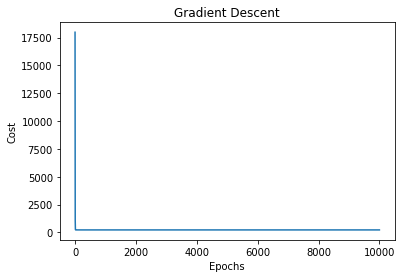

In [96]:
plt.plot(range(1, len(reg_GD.costs) + 1), reg_GD.costs)
plt.xlabel('Epochs')
plt.ylabel('Cost')
plt.title('Gradient Descent')
plt.show()

In [97]:
#Cách 2: So sánh với Normal Equation
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X_train,y_train)
y_pred_NE = np.dot(X_test,beta1)
#print(y_pred_NE)

In [98]:
# Cách 3: Kiểm chứng bằng thư viện
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_train, y_train)
y_pred_L = reg.predict(X_test)
#print(y_pred_L)

In [99]:
#Cách 4:
reg_SGD = SGDRegressor(eta0=0.001, max_iter=20,random_state=1, l1_ratio=0, tol=None, learning_rate='constant')
reg_SGD.fit(X_train, y_train)
y_pred_SGD = reg_SGD.predict(X_test)
#print(y_pred_SGD)

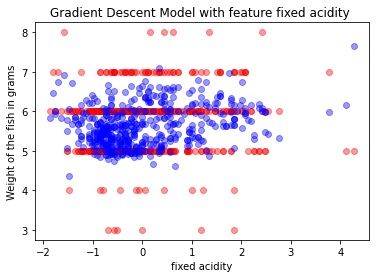

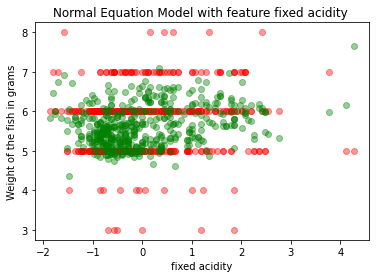

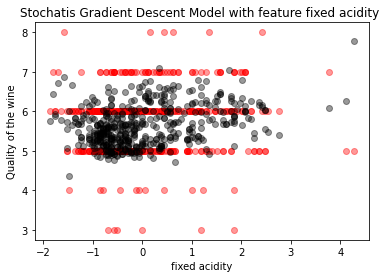

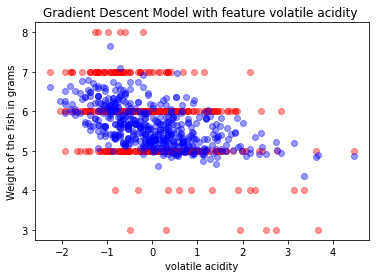

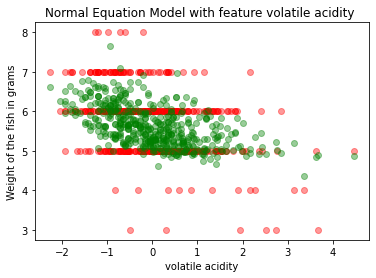

...

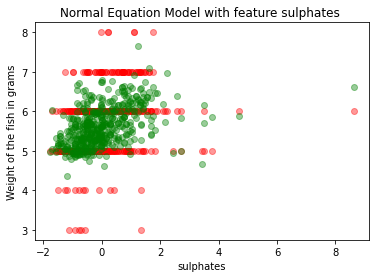

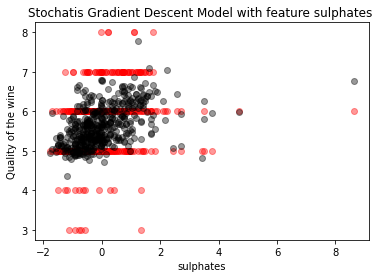

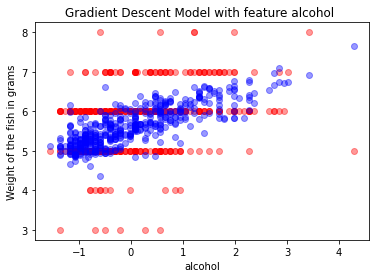

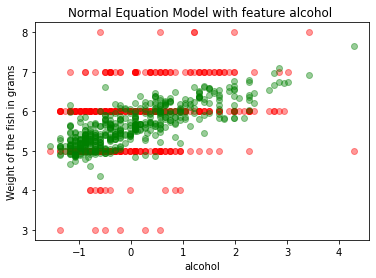

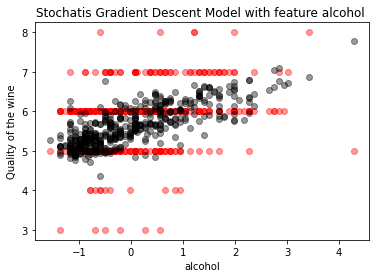

In [100]:
X_train = pd.DataFrame(X_train, columns = wine_feature_names)
X_test = pd.DataFrame(X_test, columns = wine_feature_names)
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_GD, color='blue', alpha=0.4) #Predicted data
  plt.title("Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Weight of the fish in grams')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_NE, color='green', alpha=0.4) #Predicted data
  plt.title("Normal Equation Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Weight of the fish in grams')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_SGD, color='Black', alpha=0.4) #Predicted data
  plt.title("Stochatis Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Quality of the wine')
  plt.show();




for feature in wine_feature_names :
  if feature != "bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [101]:
from sklearn.metrics import r2_score
print(r2_score(y_test, y_pred_NE))
print(r2_score(y_test, y_pred_GD))
print(r2_score(y_test, y_pred_SGD))

0.2679612095684326
0.2679612095684324
0.26912159640921496


In [102]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_pred_NE,y_test))
print(mean_squared_error(y_pred_GD,y_test))
print(mean_squared_error(y_pred_SGD,y_test))

0.4935892280049237
0.49358922800492394
0.4928068180392016


# ***Weather***

# Khai báo thư viện 


In [103]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from plotly.offline import init_notebook_mode, iplot, plot

import plotly as py
init_notebook_mode(connected=True)
import plotly.graph_objs as go

from collections import Counter


# Tải và kiểm tra dữ liệu

In [104]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [105]:
cd "/content/drive/MyDrive/Toán cho KHMT/data"

/content/drive/MyDrive/Toán cho KHMT/data


In [106]:
weather = pd.read_csv('./weather.csv')
type(weather)
weather.describe

<bound method NDFrame.describe of       Temperature_c  Humidity  ...  Rain  Description
0         -0.555556      0.92  ...     0         Cold
1         21.111111      0.73  ...     1         Warm
2         16.600000      0.97  ...     1       Normal
3          1.600000      0.82  ...     1         Cold
4          2.194444      0.60  ...     1         Cold
...             ...       ...  ...   ...          ...
9995      10.022222      0.95  ...     1       Normal
9996       8.633333      0.64  ...     1       Normal
9997       5.977778      0.93  ...     1       Normal
9998       9.788889      0.78  ...     1       Normal
9999      11.138889      0.79  ...     1       Normal

[10000 rows x 8 columns]>

In [107]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         10000 non-null  float64
 1   Humidity              10000 non-null  float64
 2   Wind_Speed_kmh        10000 non-null  float64
 3   Wind_Bearing_degrees  10000 non-null  int64  
 4   Visibility_km         10000 non-null  float64
 5   Pressure_millibars    10000 non-null  float64
 6   Rain                  10000 non-null  int64  
 7   Description           10000 non-null  object 
dtypes: float64(5), int64(2), object(1)
memory usage: 625.1+ KB


In [108]:
print(str('Có giá trị rỗng nào trong bảng không ?: '), weather.isnull().values.any())

Có giá trị rỗng nào trong bảng không ?:  False


In [109]:
weather.style.background_gradient(cmap='viridis')

#Xử lí dữ liệu


Liệt kê các đặc trưng của bảng

In [110]:
a= []
for c in weather :
  a.append(c)
print(a)

['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description']


Mô tả mối liên hệ giữa các thuộc tính của bảng

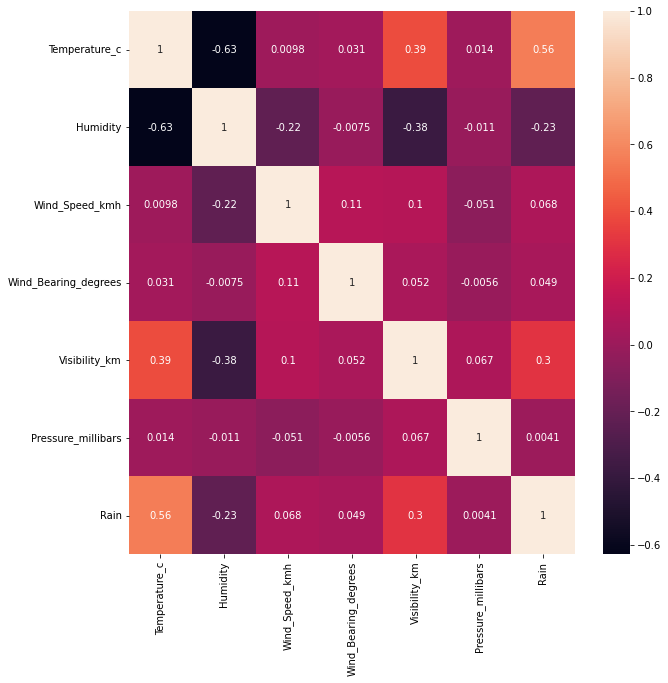

In [111]:
fig, ax = plt.subplots(figsize=(10,10)) 
sns.heatmap(weather[['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description']].corr(), annot = True)
plt.show()

Qua đây ta thấy Rain có tương quan cao nhất với Temperature, các trường dữ liệu Wind_Bearing_degrees, Pressure_millibars thì có tương quan rất thấp nhất với Temperature với thấp với các trường dữ liệu còn lại. 

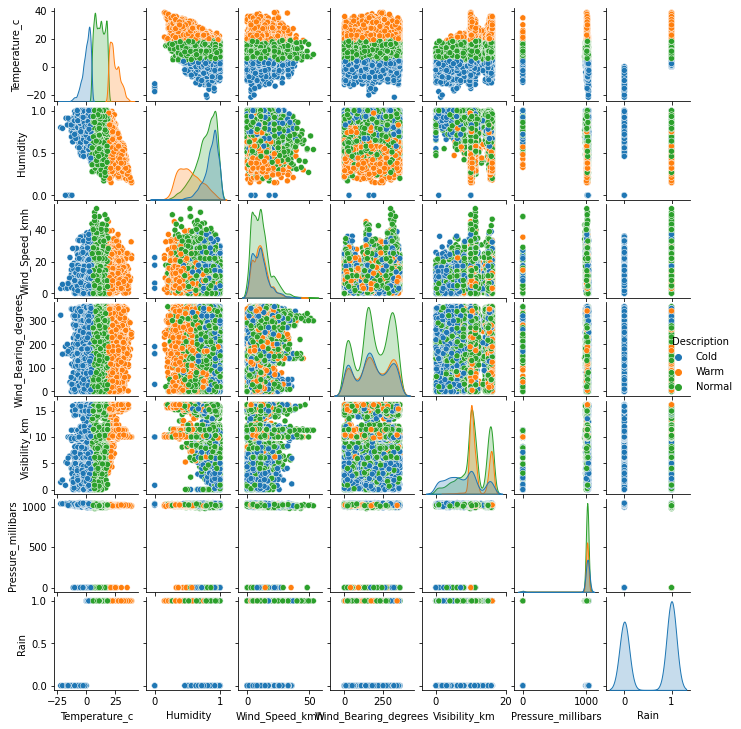

In [112]:
g = sns.pairplot(weather, kind='scatter', hue='Description')
g.fig.set_size_inches(10,10)

In [113]:
print(weather['Description'].unique())
weather['Description'] = LabelEncoder().fit_transform(weather['Description']) 
print(weather['Description'].unique())

['Cold' 'Warm' 'Normal']
[0 2 1]


In [114]:
sp = weather['Description'].value_counts()
sp = pd.DataFrame(sp)
sp

,Description
1,4992
2,2507
0,2501


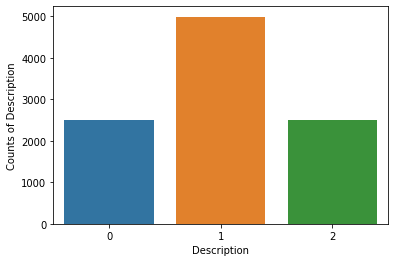

In [115]:
sns.barplot(x=sp.index, y=sp['Description']);
plt.xlabel('Description')
plt.ylabel('Counts of Description')
plt.show()

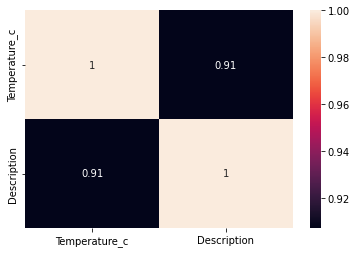

In [116]:
sns.heatmap(weather[['Temperature_c',  'Description']].corr(), annot = True)


Ta nhận thấy Description cho ra tương quan rất cao với Temperature. Đây là tín hiệu khả quan để ta train được kết quả tốt :))

Giờ ta sẽ loại bỏ những cá thể trong bảng khác biệt với phần còn lại của dữ liệu

In [117]:
def detect_outliers(df,features):
    x = len(features)
    outlier_indices = []
    
    for c in features:
        # 1st quartile
        Q1 = np.percentile(df[c],25)
        # 3rd quartile
        Q3 = np.percentile(df[c],75)
        # IQR
        IQR = Q3 - Q1
        # Outlier step
        outlier_step = IQR * 1.5
        # detect outlier and their indeces
        outlier_list_col = df[(df[c] < Q1 - outlier_step) | (df[c] > Q3 + outlier_step)].index
        # store indeces
        outlier_indices.extend(outlier_list_col)
    
    outlier_indices = Counter(outlier_indices)
    if x == 1:
      multiple_outliers = list(i for i, v in outlier_indices.items())
    else:
      multiple_outliers = list(i for i, v in outlier_indices.items() if v > 2)
    #print(multiple_outliers)
    return multiple_outliers

In [118]:
x = detect_outliers(weather,['Temperature_c', 'Humidity', 'Wind_Speed_kmh', 'Wind_Bearing_degrees', 'Visibility_km', 'Pressure_millibars', 'Rain', 'Description'])
new_weather = weather.loc[x]
print(new_weather.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4 entries, 4181 to 7416
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         4 non-null      float64
 1   Humidity              4 non-null      float64
 2   Wind_Speed_kmh        4 non-null      float64
 3   Wind_Bearing_degrees  4 non-null      int64  
 4   Visibility_km         4 non-null      float64
 5   Pressure_millibars    4 non-null      float64
 6   Rain                  4 non-null      int64  
 7   Description           4 non-null      int64  
dtypes: float64(5), int64(3)
memory usage: 288.0 bytes
None


In [119]:
new_weather.style.background_gradient(cmap='viridis')

,Temperature_c,Humidity,Wind_Speed_kmh,Wind_Bearing_degrees,Visibility_km,Pressure_millibars,Rain,Description
4181,-17.294444,0.910000,3.638600,161,5.200300,1035.900000,0,0
4526,-17.777778,0.000000,3.220000,190,0.805000,1035.000000,0,0
4975,-5.050000,0.540000,33.214300,20,9.982000,1041.250000,0,0
7416,-1.111111,0.750000,27.080200,150,11.205600,0.000000,0,0


In [120]:
weather = weather.drop(x)


In [121]:
weather.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9996 entries, 0 to 9999
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Temperature_c         9996 non-null   float64
 1   Humidity              9996 non-null   float64
 2   Wind_Speed_kmh        9996 non-null   float64
 3   Wind_Bearing_degrees  9996 non-null   int64  
 4   Visibility_km         9996 non-null   float64
 5   Pressure_millibars    9996 non-null   float64
 6   Rain                  9996 non-null   int64  
 7   Description           9996 non-null   int64  
dtypes: float64(5), int64(3)
memory usage: 702.8 KB


In [122]:
weather_feature_names = ['Bias','Humidity', 'Wind_Speed_kmh', 'Visibility_km', 'Rain', 'Description']
#fish_feature_names = fish.columns[2:].values.tolist()
print(len(weather_feature_names))
print(weather_feature_names)

6
['Bias', 'Humidity', 'Wind_Speed_kmh', 'Visibility_km', 'Rain', 'Description']


#Tiến hành train dữ liệu

In [123]:
X = weather.drop(columns=['Temperature_c','Pressure_millibars','Wind_Bearing_degrees'])
y = weather['Temperature_c']

X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
#scaler = StandardScaler() 
X_train = StandardScaler().fit_transform(X_train)
X_test = StandardScaler().fit_transform(X_test)
# Thêm hệ số tự do để 
X_train = np.c_[np.ones((len(X_train), 1)), X_train]
X_test = np.c_[np.ones((len(X_test), 1)), X_test]

#print(X_train)
#print(X_test)

In [124]:
# Cách 1: Gradient Descent
reg_GD = LinearRegression_GD(eta=0.0001, max_iter=10000,random_state=1)
reg_GD.fit(X_train, y_train)
y_pred_GD = reg_GD.predict(X_test)
#print(y_pred_GD)

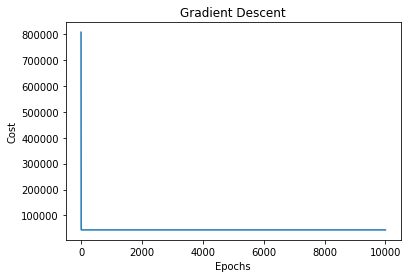

In [125]:
plt.plot(range(1, len(reg_GD.costs) + 1), reg_GD.costs)
plt.xlabel('Epochs')
plt.ylabel('Cost')
plt.title('Gradient Descent')
plt.show()

In [126]:
#Cách 2: So sánh với Normal Equation
def get_best_param(X, y):  
    X_transpose = X.T  
    best_params = np.linalg.inv(X_transpose.dot(X)).dot(X_transpose).dot(y)  
    # normal equation  
    # theta_best = (X.T * X)^(-1) * X.T * y  
      
    return best_params # returns a list  
beta1 = get_best_param(X_train,y_train)
y_pred_NE = np.dot(X_test,beta1)
#print(y_pred_NE)

In [127]:
# Cách 3: Kiểm chứng bằng thư viện
from sklearn.linear_model import LinearRegression
reg = LinearRegression().fit(X_train, y_train)
y_pred_L = reg.predict(X_test)
#print(y_pred_L)

In [128]:
#Cách 4:
reg_SGD = SGDRegressor(eta0=0.001, max_iter=20,random_state=1, l1_ratio=0, tol=None, learning_rate='constant')
reg_SGD.fit(X_train, y_train)
y_pred_SGD = reg_SGD.predict(X_test)
#print(y_pred_SGD)

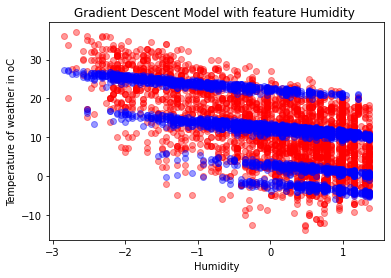

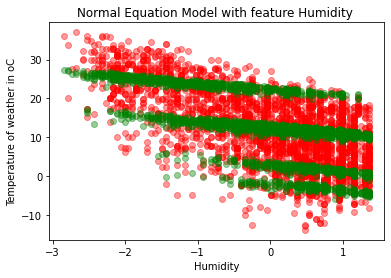

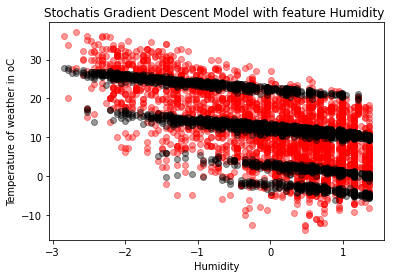

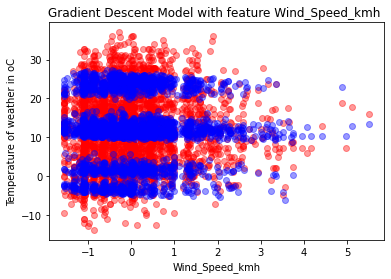

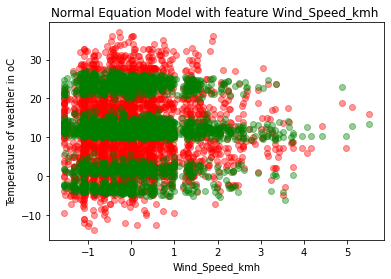

...

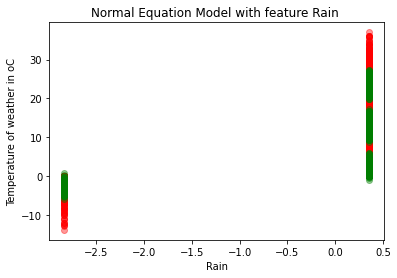

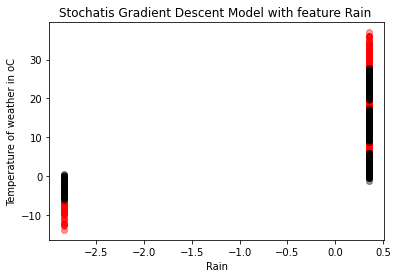

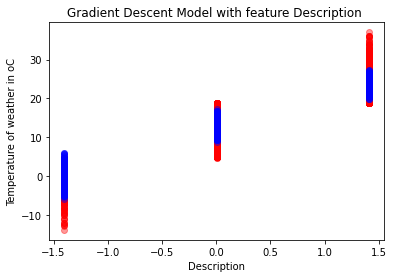

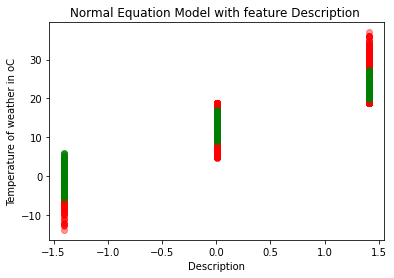

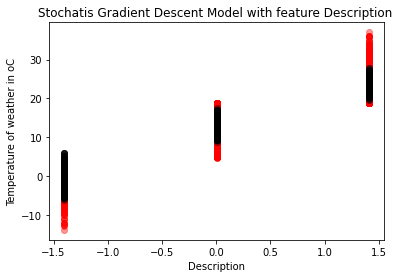

In [132]:
X_train = pd.DataFrame(X_train, columns = weather_feature_names)
X_test = pd.DataFrame(X_test, columns = weather_feature_names)
def visualize_result(feature):
  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_GD, color='blue', alpha=0.4) #Predicted data
  plt.title("Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Temperature of weather in oC')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_NE, color='green', alpha=0.4) #Predicted data
  plt.title("Normal Equation Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Temperature of weather in oC')
  plt.show();

  plt.scatter(X_test[feature], y_test, color='red', alpha=0.4) #Real data
  plt.scatter(X_test[feature], y_pred_SGD, color='Black', alpha=0.4) #Predicted data
  plt.title("Stochatis Gradient Descent Model with feature {} ".format(feature))
  plt.xlabel('{}'.format(feature))
  plt.ylabel('Temperature of weather in oC')
  plt.show();




for feature in weather_feature_names :
  if feature != "Bias":
    visualize_result(feature)

Hình ảnh này cho ta thấy, kết quả dự đoán không cho ra kết quả hiệu quả cao lắm. Các điểm dữ liệu dự đoán khá xa với các điểm dữ liệu test. 


In [133]:
from sklearn.metrics import r2_score
print(r2_score(y_test, y_pred_NE))
print(r2_score(y_test, y_pred_GD))
print(r2_score(y_test, y_pred_SGD))

0.8628049129704674
0.8628049129704674
0.8624370647748063


In [134]:
from sklearn.metrics import mean_squared_error
print(mean_squared_error(y_pred_NE,y_test))
print(mean_squared_error(y_pred_GD,y_test))
print(mean_squared_error(y_pred_SGD,y_test))

12.423130905213238
12.42313090521324
12.456439869746054
